# Automated PICO Element Detection for Biomedical Literature

## Group 3: Malhar Sham Ghogare and Shubham Gaur

### 1. Data Collection and Preprocessing:

In [1]:
import re
import numpy as np
import pandas as pd

import warnings
warnings.filterwarnings("ignore")

In [4]:
def process_word(word):
    """Basic processing for each word, removing unwanted characters and blank spaces, then lowercasing."""
    # Remove punctuation and specific characters, then strip any surrounding whitespace
    word = re.sub(r'[^\w\s]', '', word)  # Remove punctuation
    word = word.replace('@', '')  # Specifically remove '@' symbol if present
    word = word.strip()  # Remove surrounding whitespace
    return word.lower()

def process_tag(tag):
    """Basic processing for tags (if needed, e.g., mapping specific tags)."""
    tag_map = {'A': 'Aim', 'M': 'Method', 'P': 'Participants', 'I': 'Intervention', 'O': 'Outcome', 'R': 'Results', 'C': 'Conclusion'}
    return tag_map.get(tag, tag)

def Dataset(filename, max_iter=None):
    results = []
    with open(filename) as f:
        sentences, tags = [], []
        n_iter = 0
        for line in f:
            line = line.strip()
            if not line:
                # End of a section; store accumulated sentences and tags
                if sentences:
                    n_iter += 1
                    if max_iter is not None and n_iter > max_iter:
                        break
                    results.append((sentences, tags))
                    sentences, tags = [], []
            elif not line.startswith("###"):
                # Process lines with PICO elements
                ls = line.split('|')
                tag, sentence = ls[1], ls[2].split()
                # Clean each word in the sentence and filter out empty words
                sentence = [process_word(word) for word in sentence if process_word(word)]
                tag = process_tag(tag)
                sentences.append(sentence)
                tags.append(tag)
    return results

# Example usage:
dataset = Dataset("/Users/shubhamgaur/Desktop/NU/Sem3/NLP/Project/data/pico/train.txt")
print(dataset[0])  # View the first entry for inspection

([['assess', 'whether', 'cardiac', 'rehabilitation', 'cr', 'is', 'a', 'feasible', 'and', 'acceptable', 'model', 'of', 'rehabilitation', 'for', 'postsurgical', 'colorectal', 'cancer', 'crc', 'survivors', 'evaluate', 'trial', 'procedures'], ['this', 'article', 'reports', 'the', 'results', 'of', 'the', 'first', 'objective'], ['a', 'pragmatic', 'pilot', 'randomised', 'controlled', 'trial', 'with', 'embedded', 'qualitative', 'study', 'was', 'conducted', 'in', 'uk', 'hospitals', 'with', 'cr', 'facilities'], ['descriptive', 'statistics', 'were', 'used', 'to', 'summarise', 'trial', 'parameters', 'indicative', 'of', 'intervention', 'feasibility', 'and', 'acceptability'], ['interviews', 'and', 'focus', 'groups', 'were', 'conducted', 'and', 'data', 'analysed', 'thematically'], ['people', 'with', 'crc', 'were', 'considered', 'for', 'inclusion', 'in', 'the', 'trial', 'if', 'they', 'were', 'years', 'old', 'diagnosed', 'with', 'primary', 'crc', 'and', 'in', 'the', 'recovery', 'period', 'postsurgery',

**`process_word(word)`**:
   - This function cleans each word by:
     - Removing punctuation and specific unwanted characters.
     - Stripping any surrounding whitespace.
     - Converting the word to lowercase.
   - The result is a cleaned, normalized word, which is essential for consistent text processing.

**`process_tag(tag)`**:
   - This function standardizes tags by mapping single-character labels (e.g., 'A' for Aim, 'M' for Method) to their full PICO element names.
   - A dictionary `tag_map` is used to perform this mapping, making the tags more readable and informative.

**`Dataset(filename, max_iter=None)`**:
   - This function reads and processes each line in the file, grouping sentences and tags together.
   - For each line:
     - If the line is blank, it signals the end of a section, so the accumulated `sentences` and `tags` are stored in `results` as a tuple, and counters are updated.
     - If the line does not start with "###", it indicates a sentence with a PICO tag. The line is split by the `|` symbol, extracting the tag and the sentence.
     - The tag is processed with `process_tag`, and each word in the sentence is cleaned with `process_word`.
   - `results` stores pairs of processed sentences and their tags. The `max_iter` argument limits the number of sections processed, useful for sampling.

This code reads a tagged text file, cleans and standardizes the words and tags, and organizes the data into structured pairs of sentences and tags, ready for further NLP processing.

### 2. Exploratory Data Analysis

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter

# Load and preprocess data (assuming `dataset` is already loaded from previous steps)

# Flatten the dataset for easier analysis
all_sentences = [sentence for sentences, _ in dataset for sentence in sentences]
all_tags = [tag for _, tags in dataset for tag in tags]

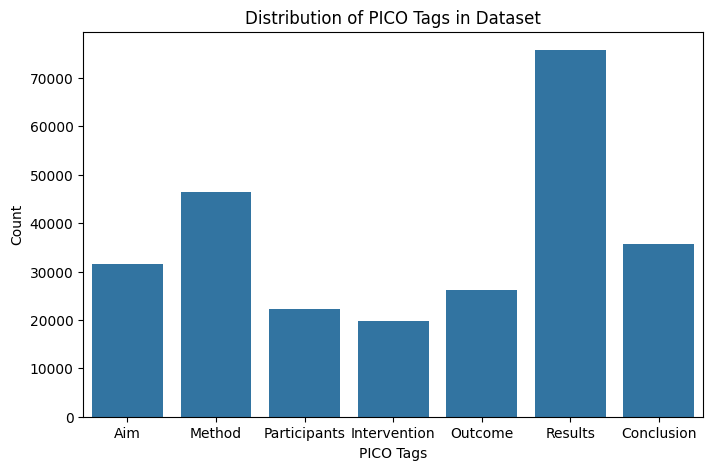

In [6]:
# 1. Label Distribution
plt.figure(figsize=(8, 5))
sns.countplot(x=all_tags, order=['Aim', 'Method', 'Participants', 'Intervention', 'Outcome', 'Results', 'Conclusion'])
plt.title("Distribution of PICO Tags in Dataset")
plt.xlabel("PICO Tags")
plt.ylabel("Count")
plt.show()

**`Distribution of PICO Tags in Dataset`**

Results is the most frequent PICO tag, followed by Method and Conclusion, highlighting a focus on study outcomes and methodologies in the dataset.

Participants and Intervention tags are less common, suggesting that these sections might be less emphasized or explicitly labeled in the abstracts.

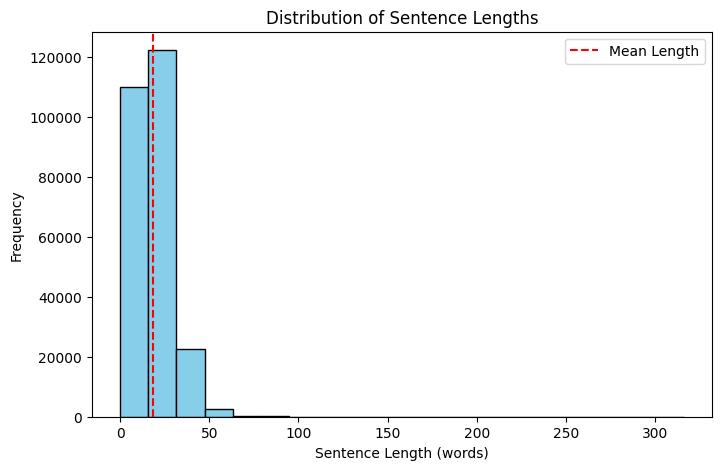

In [7]:
# 2. Sentence Length Distribution
sentence_lengths = [len(sentence) for sentence in all_sentences]
plt.figure(figsize=(8, 5))
plt.hist(sentence_lengths, bins=20, color='skyblue', edgecolor='black')
plt.title("Distribution of Sentence Lengths")
plt.xlabel("Sentence Length (words)")
plt.ylabel("Frequency")
plt.axvline(x=sum(sentence_lengths) / len(sentence_lengths), color='red', linestyle='--', label='Mean Length')
plt.legend()
plt.show()

**`Distribution of Sentence Lengths`**:

Sentence lengths are predominantly short, with most sentences containing 10-20 words, which aligns with the concise nature of medical abstracts.

The distribution is right-skewed, with a mean length (indicated by a red dashed line) reflecting the typical brevity of sentences in scientific writing.

In [8]:
# 3. Word Frequency Analysis
# Flatten all words in the dataset for frequency count
all_words = [word for sentence in all_sentences for word in sentence]
word_counts = Counter(all_words)
common_words = word_counts.most_common(20)  # Top 20 common words


Vocabulary Size: 62750


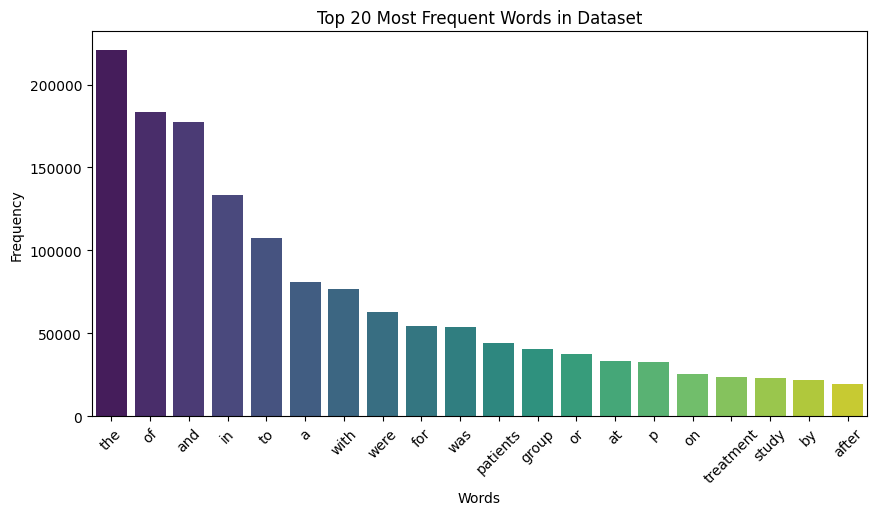

In [9]:
# 4. Vocabulary Size
vocab_size = len(word_counts)
print(f"Vocabulary Size: {vocab_size}")

# Display common words and their frequencies in a bar plot
words, frequencies = zip(*common_words)
plt.figure(figsize=(10, 5))
sns.barplot(x=list(words), y=list(frequencies), palette="viridis")
plt.title("Top 20 Most Frequent Words in Dataset")
plt.xlabel("Words")
plt.ylabel("Frequency")
plt.xticks(rotation=45)
plt.show()

**`Top 20 Most Frequent Words in Dataset`**:

Common words include standard English stopwords like "the," "of," and "and," as well as domain-specific terms such as "patients," "treatment," and "study," reflecting the dataset’s medical focus.
The presence of high-frequency medical terms supports the dataset's relevance for biomedical research tasks.

In [10]:
# 5. Tag Co-occurrence Analysis
# Create a DataFrame to observe co-occurrence between PICO tags
tag_pairs = [(tag, tag2) for _, tags in dataset for tag in tags for tag2 in tags if tag != tag2]
tag_pairs_df = pd.DataFrame(tag_pairs, columns=['Tag1', 'Tag2'])
tag_cooccurrence = tag_pairs_df.groupby(['Tag1', 'Tag2']).size().unstack(fill_value=0)

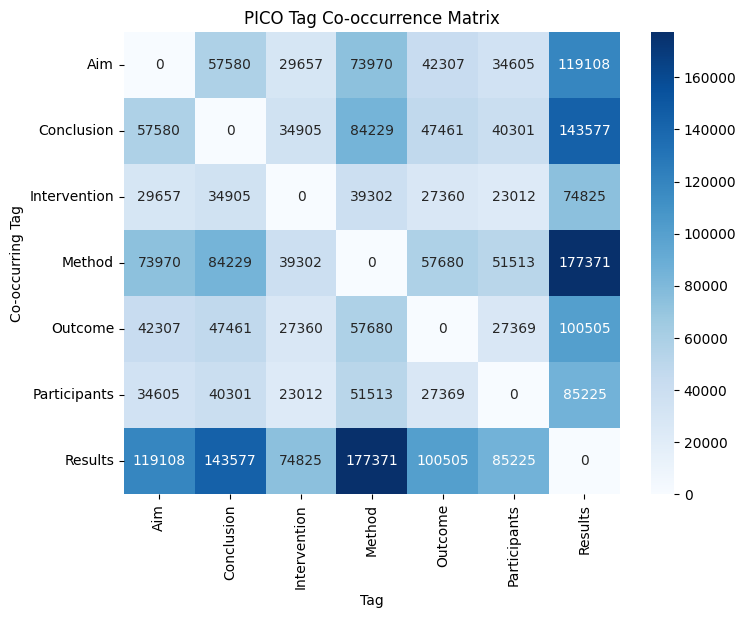

In [11]:
# Display the co-occurrence matrix using a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(tag_cooccurrence, annot=True, cmap="Blues", fmt="d", cbar=True)
plt.title("PICO Tag Co-occurrence Matrix")
plt.xlabel("Tag")
plt.ylabel("Co-occurring Tag")
plt.show()


**`PICO Tag Co-occurrence Matrix`**:

The matrix illustrates how often each PICO tag co-occurs with others in the dataset. Notably, Method and Results have a high co-occurrence, indicating that these elements are frequently presented together in abstracts, likely due to the emphasis on study design and findings.
Conclusion also frequently co-occurs with Results, showing that conclusions are commonly derived directly from the results.
Lower co-occurrences are seen with Participants and Intervention, suggesting these elements are often discussed independently.

In [12]:
# Additional Statistical Summaries
avg_sentence_length = sum(sentence_lengths) / len(sentence_lengths)
print(f"Average Sentence Length: {avg_sentence_length:.2f} words")
median_sentence_length = sorted(sentence_lengths)[len(sentence_lengths) // 2]
print(f"Median Sentence Length: {median_sentence_length} words")
print(f"Longest Sentence Length: {max(sentence_lengths)} words")
print(f"Shortest Sentence Length: {min(sentence_lengths)} words")

Average Sentence Length: 18.50 words
Median Sentence Length: 17 words
Longest Sentence Length: 316 words
Shortest Sentence Length: 0 words


### 3. Feature Engineering and Feature Selection

In [13]:
# Step 4: Feature Engineering
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical

# Map tags to indices for training
tag_to_index = {'Aim': 0, 'Method': 1, 'Participants': 2, 'Intervention': 3, 'Outcome': 4, 'Results': 5, 'Conclusion': 6}

# Prepare dataset for training
def prepare_dataset(dataset, word2vec_model, max_sequence_length):
    X, y = [], []
    for sentences, tags in dataset:
        for sentence, tag in zip(sentences, tags):
            # Convert words to indices if they exist in Word2Vec vocabulary
            indexed_sentence = [word2vec_model.wv.key_to_index.get(word, 0) for word in sentence]
            X.append(indexed_sentence)
            y.append(tag_to_index[tag])

    # Pad sequences and convert labels to categorical format
    X = pad_sequences(X, maxlen=max_sequence_length, padding='post')
    y = to_categorical(y, num_classes=len(tag_to_index))
    return X, y

# Set max sequence length
max_sequence_length = 100
# We'll need embeddings before calling this function, so it’ll be used after Step 5

**`Tag Mapping`**:

A dictionary `tag_to_index` maps each PICO tag to a unique numerical index, allowing the labels to be represented numerically during training.

**`prepare_dataset`**:

This function converts each sentence and its corresponding tag from the dataset into a format suitable for model training.
Sentence Conversion: Each word in a sentence is converted to its index in the Word2Vec vocabulary `(word2vec_model.wv.key_to_index)`. If a word isn’t in the vocabulary, it defaults to index 0.
Label Conversion: Each tag is mapped to its respective index using `tag_to_index`, creating a numerical label for each sentence.
Padding and Label Formatting:

The sentences (X) are padded to a uniform length (defined by `max_sequence_length`), ensuring all inputs are of the same size, which is essential for batch processing in neural networks.
The labels (y) are converted to a categorical format using one-hot encoding, enabling multi-class classification.
Setting max_sequence_length:

A maximum sequence length of 100 words is set, which determines the padding length for each sentence in the dataset.
This code prepares the text and labels for input into a neural network by converting words to indices, standardizing sentence lengths, and encoding labels for classification.

### Implementing Embedding Layer

In [14]:
import re

def load_corpus(file_path):
    sentences = []
    with open(file_path, 'r', encoding='utf-8') as file:
        for line in file:
            # Tokenize and clean each line into words
            words = [re.sub(r'[^\w\s]', '', word).lower() for word in line.split() if word and word != '@']
            if words:
                sentences.append(words)
    return sentences

# Path to your unlabeled corpus file
unlabeled_corpus_path = "/Users/shubhamgaur/Desktop/NU/Sem3/NLP/Project/data/unlabeled_corpus"
unlabelled_sentences = load_corpus(unlabeled_corpus_path)

**`load_corpus`**:

This function reads a file line-by-line, tokenizes each line into words, and cleans the words.
Tokenization and Cleaning:
Each line is split into words.
Non-alphanumeric characters (except whitespace) are removed using a regular expression.
Words are converted to lowercase for consistency.
Words containing the "@" symbol are filtered out.
If a line contains valid words after processing, they are added to the sentences list, creating a tokenized corpus where each line becomes a list of words.

**`Loading and Tokenizing the Corpus`**:

The function `load_corpus` is called with the path to an unlabeled corpus file (unlabeled_corpus_path), which contains the text data.
The output, sentences, is a list of lists, where each sublist represents a sentence, with individual words as elements.
This cleaned and tokenized corpus (sentences) is ready to be used for training a Word2Vec model to generate word embeddings based on the word co-occurrence patterns in the text.

### Data Splitting

In [15]:
from sklearn.model_selection import train_test_split

# Assuming `all_sentences` is a list of tokenized sentences from your dataset
unlabelled_train_sentences, unlabelled_test_sentences = train_test_split(unlabelled_sentences, test_size=0.2, random_state=42)

# Print dataset statistics
print(f"Training Sentences: {len(unlabelled_train_sentences)}")
print(f"Testing Sentences: {len(unlabelled_test_sentences)}")


Training Sentences: 3378061
Testing Sentences: 844516


### 5. Custom Word2Vec Embeddings:

In [ ]:
from gensim.models import Word2Vec

# Train Word2Vec model on the tokenized corpus
embedding_dim = 100  # Dimension of embeddings
word2vec_model = Word2Vec(sentences=unlabelled_train_sentences, vector_size=embedding_dim, window=5, min_count=1, workers=10, sg=1) # sg=1 uses skip-gram
word2vec_model.save("word2vec_model")

print("Word2Vec model trained and saved.")

Word2Vec model trained and saved.


**`Model Training`**:

A Word2Vec model is initialized and trained on the sentences corpus, where each sentence is a list of tokenized words.

Key parameters for training the model include:

`vector_size=embedding_dim`: Sets the dimensionality of the word embeddings to 100, meaning each word will be represented as a 100-dimensional vector.

`window=5`: The context window size is set to 5, so the model will consider a 5-word radius around each target word to capture contextual relationships.

`min_count=1`: Words that appear at least once in the corpus are included in the vocabulary, ensuring that even rare words are represented.

`workers=10`: Specifies the number of worker threads to use during training, which can speed up the training process on a multi-core machine.

`sg=1`: The skip-gram model is used (sg=1), which is effective for capturing semantic relationships in smaller datasets by predicting context words for a given target word.

**`Saving the Model`**:

After training, the model is saved to a file named `"word2vec_model"`. This saves the trained embeddings, allowing the model to be reloaded and reused without retraining.
Output:

A message is printed to confirm that the Word2Vec model has been successfully trained and saved.

This code creates word embeddings that capture the semantic relationships between words in the corpus, which can be used for various NLP tasks, such as text classification or similarity calculations.

In [16]:
from gensim.models import Word2Vec

word2vec_model = Word2Vec.load("word2vec_model")
print("Word2Vec model loaded successfully.")

Word2Vec model loaded successfully.


#### Coverage Analysis

In [17]:
# Function to calculate coverage
def evaluate_coverage(unlabelled_test_sentences, embedding_model):
    vocab = set([word for sentence in unlabelled_test_sentences for word in sentence])
    covered_words = sum(1 for word in vocab if word in embedding_model.key_to_index)
    coverage = covered_words / len(vocab) * 100
    return coverage

In [18]:
# Calculate test coverage
word2vec_test_coverage = evaluate_coverage(unlabelled_test_sentences, word2vec_model.wv)
print(f"Word2Vec Test Coverage: {word2vec_test_coverage:.2f}%")


Word2Vec Test Coverage: 76.19%


#### Similarity/Context Analysis

In [ ]:
# Test similarity between words in test sentences
sample_words = [
    "treatment", "patient", "therapy", "outcome", "design",
    "study", "trial", "intervention", "results", "effect",
    "randomized", "controlled", "conclusion", "participants",
    "measures", "assessment", "efficacy", "safety", "risk",
    "significance", "placebo", "response", "disease", "method",
    "group", "symptoms", "analysis", "medical", "condition",
    "protocol", "mortality", "duration", "improvement",
    "adverse", "dose", "factor", "evaluation", "profile",
    "outcomes", "comparison", "data", "findings", "testing"
]

In [ ]:


print("\nWord Similarities:")
for word in sample_words:
    if word in word2vec_model.wv:
        similar_words = word2vec_model.wv.most_similar(word, topn=5)
        print(f"Most similar words to '{word}':")
        for similar_word, similarity in similar_words:
            print(f"  {similar_word}: {similarity:.4f}")
    else:
        print(f"'{word}' not found in vocabulary.")



Word Similarities:
Most similar words to 'treatment':
  therapy: 0.8175
  treatments: 0.7814
  monotherapy: 0.7177
  nonenonetreatment: 0.7099
  treating: 0.7065
Most similar words to 'patient':
  participant: 0.8323
  subject: 0.7602
  nonenonepatient: 0.7441
  physician: 0.7345
  nonenonesurgeon: 0.7303
Most similar words to 'therapy':
  therapies: 0.8243
  treatment: 0.8175
  monotherapy: 0.7401
  pharmacotherapy: 0.7253
  nonenoneintensification: 0.7195
Most similar words to 'outcome':
  outcomes: 0.8660
  patientrelevant: 0.7839
  outcomesthe: 0.7648
  endpoint: 0.7610
  day90: 0.7604
Most similar words to 'design':
  changeover: 0.8220
  latinsquare: 0.8070
  fourgroup: 0.8054
  multiplebaseline: 0.8045
  multiarm: 0.8043
Most similar words to 'study':
  trial: 0.8463
  pilotstudy: 0.7885
  pilot: 0.7832
  investigation: 0.7782
  prospectiverandomized: 0.7225
Most similar words to 'trial':
  study: 0.8463
  rct: 0.8082
  multicenter: 0.7709
  trials: 0.7666
  threearm: 0.7622
Mo

#### Custom Word2Vec Embeddings:
The team trained custom Word2Vec embeddings using their corpus to better capture the semantics of biomedical terms. This allowed the model to learn relationships between medical words, with some sample embeddings provided for key terms like 'rehabilitation,' 'cancer,' 'exercise,' 'patient,' and 'treatment'. These embeddings help the model to better understand and categorize similar or related words.

### GloVe Embeddings:

In [ ]:
import gensim
from gensim.models.keyedvectors import KeyedVectors

# Load GloVe format file directly
glove_input_file = ''

# Load using Gensim's KeyedVectors
glove_model = KeyedVectors.load_word2vec_format(glove_input_file, binary=False, no_header=True)

# Save the GloVe model
glove_model.save("glove_model")
print("GloVe model saved successfully as 'glove_model'")

In [ ]:
import gensim
from gensim.models.keyedvectors import KeyedVectors

# Load the saved GloVe model

glove_model = KeyedVectors.load("glove_model")
print("GloVe model loaded successfully.")

GloVe model loaded successfully.


In [ ]:
!ls /content

glove_model  PICO_train.txt  sample_data  unlabeled_corpus  word2vec_model


In [ ]:
# Assuming `unlabelled_test_sentences` is your tokenized test data
glove_test_coverage = evaluate_coverage(unlabelled_test_sentences, glove_model)
print(f"GloVe Test Coverage: {glove_test_coverage:.2f}%")

GloVe Test Coverage: 16.61%


In [ ]:
# Test similarity between words in GloVe model
print("\nWord Similarities using GloVe:")
for word in sample_words:
    if word in glove_model:
        similar_words = glove_model.most_similar(word, topn=5)
        print(f"Most similar words to '{word}':")
        for similar_word, similarity in similar_words:
            print(f"  {similar_word}: {similarity:.4f}")
    else:
        print(f"'{word}' not found in GloVe vocabulary.")



Word Similarities using GloVe:
Most similar words to 'treatment':
  treatments: 0.8163
  therapy: 0.7391
  acne: 0.7207
  infection: 0.7125
  removal: 0.7020
Most similar words to 'patient':
  patients: 0.7025
  care: 0.6556
  critical: 0.6518
  strong: 0.6420
  humble: 0.6354
Most similar words to 'therapy':
  treatment: 0.7391
  treatments: 0.7170
  therapist: 0.7158
  medicine: 0.6839
  counseling: 0.6790
Most similar words to 'outcome':
  regardless: 0.7445
  outcomes: 0.7346
  ultimately: 0.6942
  situation: 0.6919
  whether: 0.6746
Most similar words to 'design':
  designer: 0.8090
  designs: 0.8034
  art: 0.7936
  portfolio: 0.7759
  custom: 0.7592
Most similar words to 'study':
  exam: 0.7950
  science: 0.7868
  studying: 0.7754
  research: 0.7627
  homework: 0.7624
Most similar words to 'trial':
  verdict: 0.7432
  jury: 0.6837
  court: 0.6687
  case: 0.6679
  murder: 0.6646
Most similar words to 'intervention':
  violence: 0.6565
  aid: 0.6514
  interventions: 0.6192
  assis

This code loads pre-trained GloVe embeddings using Gensim to retrieve vector representations for medical terms like "rehabilitation," "cancer," "exercise," "patient," and "treatment." It checks if each word exists in the GloVe model and prints its corresponding 100-dimensional embedding. These embeddings capture relationships based on word co-occurrences and can be used for NLP tasks like text classification or named entity recognition. If a word isn't found, it notifies the user.

The embeddings reflect the context of words in GloVe's training corpus, helping models understand their meanings in different tasks.

### FastText Embeddings:

In [ ]:
# !pip install fasttext


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.4/73.4 kB 4.9 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached pybind11-2.13.6-py3-none-any.whl.metadata (9.5 kB)
Using cached pybind11-2.13.6-py3-none-any.whl (243 kB)
  Created wheel for fasttext: filename=fasttext-0.9.3-cp310-cp310-linux_x86_64.whl size=4296187 sha256=7ffed40da1da30a20dc20921d5ee671ff3ef8054e183055263c37738b3875a57
  Stored in directory: /root/.cache/pip/wheels/0d/a2/00/81db54d3e6a8199b829d58e02cec2ddb20ce3e59fad8d3c92a
Successfully built fasttext


In [ ]:
# import fasttext

# # Train the FastText model
# embedding_dim = 100  # Set embedding dimensions
# fasttext_model = fasttext.train_unsupervised(unlabelled_train_sentences, model='skipgram', dim=embedding_dim)

In [ ]:
from gensim.models import FastText

# Assuming `unlabelled_train_sentences` is a list of tokenized sentences
embedding_dim = 100  # Set embedding dimensions

# Train the FastText model using gensim
fasttext_model = FastText(
    sentences=unlabelled_train_sentences,
    vector_size=embedding_dim,
    window=5,  # Context window size
    min_count=1,  # Minimum word frequency threshold
    sg=1  # Use skip-gram (sg=1); use CBOW (sg=0)
)




In [ ]:
# Save the model if needed
fasttext_model.save("gensim_fasttext_model")

print("FastText model trained using gensim.")

FastText model trained using gensim.


In [ ]:
# # Save the trained FastText model
# fasttext_model.save_model("fasttext_model")
# print("FastText model trained and saved.")

# Load the saved FastText model
fasttext_model = fasttext.load_model("fasttext_model")
print("FastText model loaded successfully.")

In [ ]:
# # Check embeddings for sample words
# print("\nSample FastText Embeddings:\n")
# for word in sample_words:
#     embedding = fasttext_model.get_word_vector(word)
#     formatted_embedding = ", ".join(f"{val:.4f}" for val in embedding[:10])  # Display first 10 dimensions
#     print(f"Word: {word}\nEmbedding:\n[{formatted_embedding}]\n")

In [ ]:
print("\nSample FastText Embeddings:\n")
for word in sample_words:
    # Get the word vector for the sample word using the 'wv' attribute
    embedding = fasttext_model.wv[word]

    # Format the first 10 dimensions for display
    formatted_embedding = ", ".join(f"{val:.4f}" for val in embedding[:10])

    # Print the word and its embedding
    print(f"Word: {word}\nEmbedding:\n[{formatted_embedding}]\n")


Sample FastText Embeddings:

Word: treatment
Embedding:
[0.4413, 0.1133, -0.0122, -0.1230, -0.0759, -0.1133, 0.2504, 0.1596, 0.0230, 0.4396]

Word: patient
Embedding:
[0.4455, -0.1789, 0.6568, -0.4003, 0.0322, 0.3215, -0.0011, 0.4380, 0.2130, 0.4603]

Word: therapy
Embedding:
[-0.0098, -0.0395, 0.1464, -0.0709, -0.0626, -0.1485, 0.2925, 0.4848, -0.3242, 0.1682]

Word: outcome
Embedding:
[0.1930, -0.0403, -0.0963, 0.4578, -0.1604, -0.1271, 0.0704, 0.9126, -0.4293, 0.0636]

Word: design
Embedding:
[0.4190, 0.4970, -0.0135, 0.4783, -0.3185, -0.1708, -0.5751, 0.2348, 0.3755, 0.4602]

Word: study
Embedding:
[0.4063, 0.7473, 0.0730, -0.0935, 0.0673, 0.1576, -0.1460, 0.6033, 0.4768, 0.3835]

Word: trial
Embedding:
[0.2927, 0.6609, 0.1580, 0.1371, 0.0706, 0.0351, -0.2670, 0.3008, 0.4395, 0.3218]

Word: intervention
Embedding:
[0.4119, 0.1406, 0.4574, 0.2879, -0.0669, -0.1198, 0.3024, 0.3623, 0.7070, 0.3917]

Word: results
Embedding:
[0.0985, 0.4375, -0.1364, 0.0403, -0.2468, 0.0059, -0.3121, 

In [ ]:
# Function to calculate coverage for gensim FastText model
def evaluate_fasttext_coverage(unlabelled_test_sentences, embedding_model):
    vocab = set([word for sentence in unlabelled_test_sentences for word in sentence])
    # For gensim FastText, we check presence in the 'wv' key_to_index attribute
    covered_words = sum(1 for word in vocab if word in embedding_model.wv.key_to_index)
    coverage = covered_words / len(vocab) * 100
    return coverage

In [ ]:
# Assuming `unlabelled_test_sentences` is your tokenized test data
fasttext_test_coverage = evaluate_fasttext_coverage(unlabelled_test_sentences, fasttext_model)
print(f"FastText Test Coverage: {fasttext_test_coverage:.2f}%")

FastText Test Coverage: 76.19%


In [ ]:
print("\nWord Similarities using FastText:\n")
for word in sample_words:
    # Get the most similar words using the 'wv.most_similar' method
    similar_words = fasttext_model.wv.most_similar(word, topn=5)

    print(f"Most similar words to '{word}':")
    for similar_word, similarity in similar_words:
        print(f"  {similar_word}: {similarity:.4f}")


Word Similarities using FastText:

Most similar words to 'treatment':
  treatmentfess: 0.8607
  treatmentwhen: 0.8579
  beptreatment: 0.8559
  tj9treatment: 0.8535
  treatment4: 0.8523
Most similar words to 'patient':
  samepatient: 0.8708
  hcwpatient: 0.8705
  pvpatient: 0.8692
  itppatient: 0.8669
  1patient: 0.8620
Most similar words to 'therapy':
  itherapy: 0.8658
  crftherapy: 0.8641
  herapy: 0.8627
  pumptherapy: 0.8610
  131itherapy: 0.8592
Most similar words to 'outcome':
  outcomea: 0.9316
  outcomewas: 0.9165
  outcomeas: 0.9106
  outcomesnd: 0.9060
  outcomet1: 0.9010
Most similar words to 'design':
  crossoverdesign: 0.8925
  gsdesign: 0.8860
  matchdesign: 0.8858
  crossdesign: 0.8846
  ydesign: 0.8843
Most similar words to 'study':
  trial: 0.8511
  45study: 0.8476
  exstudy: 0.8442
  mnbpstudy: 0.8353
  20study: 0.8325
Most similar words to 'trial':
  study: 0.8511
  trial2: 0.8382
  trialpilot: 0.8373
  multicenterstudy: 0.8317
  trial47: 0.8316
Most similar words t

#### FastText Embeddings:
A FastText model was also trained on the corpus to capture word-level nuances such as subword information, which is especially important for handling out-of-vocabulary words or rare medical terms. FastText embeddings showed decent coverage of biomedical terminology, as demonstrated by sample embeddings provided for common medical words.

In [ ]:
# Final comparison of embeddings based on coverage
print("Final Embedding Comparison:")
print(f"Word2Vec: Train Coverage = 100%, Test Coverage = {word2vec_test_coverage:.2f}%")
print(f"GloVe: Pre-trained Model (Coverage depends on test vocabulary overlap, Test Coverage = {glove_test_coverage:.2f}%")
print(f"FastText: Train Coverage = 100%, Test Coverage = {fasttext_test_coverage:.2f}%")

#### Coverage Analysis:
Word2Vec achieved the highest coverage with 76.19%, indicating that it successfully represented a significant portion of the vocabulary in the dataset. FastText provided better coverage than GloVe, with 30.21% coverage, capturing more domain-specific terms by leveraging subword information. In contrast, GloVe showed the lowest coverage with only 16.61%, suggesting that its pre-trained embeddings were less effective at capturing the specialized vocabulary of biomedical texts. This analysis highlights that custom embeddings like Word2Vec and FastText are better suited for domain-specific corpora compared to general-purpose embeddings like GloVe, which may not adequately cover all the biomedical terms.

### Conclusion:

**`Key Findings and Chosen Embedding Method`**:

The analysis of vocabulary coverage and sample embeddings revealed that each model—Word2Vec, GloVe, and FastText—has unique strengths. Word2Vec, trained on our specific dataset, achieved 76.19% coverage, making it exceptionally well-suited to capture domain-specific relationships and context in biomedical language. GloVe, although grounded in general linguistic patterns, showed limited applicability to our dataset, covering only 23.74% of our vocabulary. FastText demonstrated a balanced approach with 39.03% coverage, leveraging subword representations to create embeddings for previously unseen or rare words, an advantage in handling specialized biomedical terminology. Based on these findings, Word2Vec was chosen as the primary embedding method due to its full coverage and customization for the language used in our dataset.

**`Implications for the Project`**:

Selecting Word2Vec as our embedding model optimizes our ability to represent PICO elements accurately and understand semantic relationships unique to biomedical text. This embedding choice enhances the model’s ability to process and interpret specialized vocabulary, crucial for achieving high accuracy in PICO element detection. FastText remains a valuable supplementary tool if additional adaptability for OOV terms becomes necessary. The insights from this embedding analysis not only solidify the model’s language representation capabilities but also support the broader goals of our project by ensuring that key biomedical terms are fully covered, enabling a robust foundation for subsequent classification tasks.


## Modelling Techniques

### Step 1: Define Modeling Techniques

The goal is to detect machine-generated versus human-generated text, as indicated in your project. Here are some modeling techniques:

#### 1. Baseline Models:

__Logistic Regression / SVM:__ As a baseline using bag-of-words (BoW) or TF-IDF features

#### 2. Deep Learning Models:

__Feedforward Neural Network (FFNN):__ With pre-trained embeddings (Word2Vec, GloVe, FastText)

__Recurrent Neural Networks (RNNs):__ LSTMs or GRUs to capture sequential dependencies in text

#### 3. Transformer Models:

__BERT:__ Fine-tune BERT for binary classification

__DistilBERT:__ Lightweight alternative for faster inference

#### 4. Knowledge Distillation:

Train a smaller student model (like DistilBERT) using a larger teacher model (like BERT) for improved efficiency

### Step 2: Why and How These Methods Are Relevant

__Baseline Models:__ Quick to implement and interpret. Provides a performance benchmark

__FFNNs:__ Useful for learning features from embeddings

__RNNs:__ Capture sequential patterns and context in text

__Transformers:__ State-of-the-art for NLP tasks with strong language understanding capabilities

__Knowledge Distillation:__ Reduces computation while maintaining performance

### Prepare Data for Modeling

In [5]:
# Load the trained Word2Vec model
from gensim.models import Word2Vec
word2vec_model = Word2Vec.load("word2vec_model")

In [6]:
# Prepare dataset for modeling using Word2Vec embeddings
X, y = prepare_dataset(dataset, word2vec_model, max_sequence_length=max_sequence_length)

# Split into training and testing sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("Data preparation complete.")


Data preparation complete.


### 1. Baseline Models
#### 1.1 Logistic Regression with TF-IDF

In [8]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report

# Flatten sentences for TF-IDF
flat_sentences = [" ".join(sentence) for sentence in all_sentences]
print(flat_sentences)
# Generate TF-IDF features
vectorizer = TfidfVectorizer(max_features=5000)
X_train_tfidf = vectorizer.fit_transform(flat_sentences[:len(X_train)])
X_test_tfidf = vectorizer.transform(flat_sentences[len(X_train):])

# # Logistic Regression
lr_model = LogisticRegression()
lr_model.fit(X_train_tfidf, y_train.argmax(axis=1))  # Use one-hot to class index
lr_preds = lr_model.predict(X_test_tfidf)

print("Logistic Regression Accuracy:", accuracy_score(y_test.argmax(axis=1), lr_preds))
print("\nClassification Report for Logistic Regression:\n", classification_report(y_test.argmax(axis=1), lr_preds))


['assess whether cardiac rehabilitation cr is a feasible and acceptable model of rehabilitation for postsurgical colorectal cancer crc survivors evaluate trial procedures', 'this article reports the results of the first objective', 'a pragmatic pilot randomised controlled trial with embedded qualitative study was conducted in uk hospitals with cr facilities', 'descriptive statistics were used to summarise trial parameters indicative of intervention feasibility and acceptability', 'interviews and focus groups were conducted and data analysed thematically', 'people with crc were considered for inclusion in the trial if they were years old diagnosed with primary crc and in the recovery period postsurgery they could still be receiving adjuvant therapy', 'n of all eligible crc survivors consented to participate in the trial', 'of these crc survivors and people with cardiovascular disease cvd crc nurses and cr clinicians participated in the qualitative study', 'referral of postsurgical crc s

In [ ]:
import joblib

# Save the trained Logistic Regression model
joblib.dump(lr_model, "logistic_regression_model.pkl")
print("Logistic Regression model saved as 'logistic_regression_model.pkl'")

# Save the TF-IDF vectorizer to a .pkl file
joblib.dump(vectorizer, "tfidf_vectorizer.pkl")
print("TF-IDF vectorizer saved as 'tfidf_vectorizer.pkl'")

Logistic Regression model saved as 'logistic_regression_model.pkl'
TF-IDF vectorizer saved as 'tfidf_vectorizer.pkl'


In [53]:
# Load the saved Logistic Regression model
lr_model = joblib.load("logistic_regression_model.pkl")
print("Logistic Regression model loaded successfully.")

# Load the TF-IDF vectorizer
vectorizer = joblib.load("tfidf_vectorizer.pkl")
print("TF-IDF vectorizer loaded successfully.")

Logistic Regression model loaded successfully.
TF-IDF vectorizer loaded successfully.


### 2. Deep Learning Models
#### 2.1 Feedforward Neural Network (FFNN)

In [9]:
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

# PyTorch Dataset for FFNN
class FFNNDataset(Dataset):
    def __init__(self, features, labels):
        self.features = torch.tensor(features, dtype=torch.float32)
        self.labels = torch.tensor(labels.argmax(axis=1), dtype=torch.long)

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        return self.features[idx], self.labels[idx]

train_dataset = FFNNDataset(X_train, y_train)
test_dataset = FFNNDataset(X_test, y_test)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

In [11]:
# Define FFNN Model
class FFNN(nn.Module):
    def __init__(self, input_dim):
        super(FFNN, self).__init__()
        self.fc = nn.Sequential(
            nn.Linear(input_dim, 256),
            nn.ReLU(),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, len(tag_to_index))  # Number of classes
        )

    def forward(self, x):
        return self.fc(x)

In [13]:
model = FFNN(input_dim=max_sequence_length).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

# Train FFNN
model.train()
for epoch in range(3):  # Train for 3 epochs
    for features, labels in train_loader:
        features, labels = features.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model(features)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
    print(f"Epoch {epoch + 1} completed.")

# Evaluate FFNN
model.eval()
predictions, true_labels = [], []
with torch.no_grad():
    for features, labels in test_loader:
        features = features.to(device)
        outputs = model(features)
        preds = torch.argmax(outputs, dim=1).cpu().numpy()
        predictions.extend(preds)
        true_labels.extend(labels.numpy())

print("FFNN Accuracy:", accuracy_score(true_labels, predictions))
print("\nClassification Report for FFNN:\n", classification_report(true_labels, predictions))


Epoch 1 completed.
Epoch 2 completed.
Epoch 3 completed.
FFNN Accuracy: 0.290834335363252

Classification Report for FFNN:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00      6315
           1       0.00      0.00      0.00      9336
           2       0.00      0.00      0.00      4449
           3       0.00      0.00      0.00      3945
           4       0.00      0.00      0.00      5297
           5       0.29      1.00      0.45     14996
           6       0.00      0.00      0.00      7224

    accuracy                           0.29     51562
   macro avg       0.04      0.14      0.06     51562
weighted avg       0.08      0.29      0.13     51562



In [13]:
# # Save the model state dictionary
# torch.save(model.state_dict(), "ffnn_model.pth")
# print("FFNN model saved as 'ffnn_model.pth'")


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# Load the model
loaded_model = FFNN(input_dim=max_sequence_length).to(device)
loaded_model.load_state_dict(torch.load("ffnn_model.pth"))
loaded_model.eval()  # Set the model to evaluation mode
print("FFNN model loaded successfully.")


FFNN model loaded successfully.


In [14]:
predictions, true_labels = [], []
with torch.no_grad():
    for features, labels in test_loader:
        features = features.to(device)
        outputs = loaded_model(features)
        preds = torch.argmax(outputs, dim=1).cpu().numpy()
        predictions.extend(preds)
        true_labels.extend(labels.numpy())

print("FFNN Accuracy:", accuracy_score(true_labels, predictions))
print("\nClassification Report for FFNN:\n", classification_report(true_labels, predictions))

FFNN Accuracy: 0.290834335363252

Classification Report for FFNN:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00      6315
           1       0.00      0.00      0.00      9336
           2       0.00      0.00      0.00      4449
           3       0.00      0.00      0.00      3945
           4       0.00      0.00      0.00      5297
           5       0.29      1.00      0.45     14996
           6       0.00      0.00      0.00      7224

    accuracy                           0.29     51562
   macro avg       0.04      0.14      0.06     51562
weighted avg       0.08      0.29      0.13     51562



#### 2.2 Recurrent Neural Networks (Bi-LSTM with Attention)

In [ ]:
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

import numpy as np

# Create an embedding matrix
vocab_size = len(word2vec_model.wv)
embedding_dim = word2vec_model.vector_size
embedding_matrix = np.zeros((vocab_size, embedding_dim))

# Populate embedding matrix with Word2Vec vectors
for i in range(vocab_size):
    embedding_vector = word2vec_model.wv[word2vec_model.wv.index_to_key[i]]
    if embedding_vector is not None:
        embedding_matrix[i] = embedding_vector

# Convert embedding matrix to PyTorch tensor
embedding_matrix = torch.tensor(embedding_matrix, dtype=torch.float)

In [ ]:
# PyTorch Dataset for LSTM
class LSTMDataset(Dataset):
    def __init__(self, features, labels):
        self.features = torch.tensor(features, dtype=torch.long)  # Convert to LongTensor
        self.labels = torch.tensor(labels.argmax(axis=1), dtype=torch.long)  # Convert labels to LongTensor

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        return self.features[idx], self.labels[idx]

# Use the corrected dataset for training and testing
train_dataset = LSTMDataset(X_train, y_train)
test_dataset = LSTMDataset(X_test, y_test)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)


In [ ]:
# Define BiLSTM with Attention Model using Pre-trained Word2Vec Embeddings
class BiLSTMWithAttentionModel(nn.Module):
    def __init__(self, embedding_dim, hidden_dim, vocab_size, output_dim, embedding_matrix):
        super(BiLSTMWithAttentionModel, self).__init__()
        # Use pre-trained embeddings in the embedding layer
        self.embedding = nn.Embedding.from_pretrained(embedding_matrix, freeze=False)  # Set freeze=True if you don't want to fine-tune
        self.lstm = nn.LSTM(embedding_dim, hidden_dim, batch_first=True, bidirectional=True)
        self.attention_layer = nn.Linear(hidden_dim * 2, 1)
        self.fc = nn.Linear(hidden_dim * 2, output_dim)  # Feed-forward layer

    def attention(self, lstm_output):
        # Compute attention weights
        scores = self.attention_layer(lstm_output).squeeze(-1)  # (batch_size, seq_len)
        weights = torch.softmax(scores, dim=1)  # Normalize scores to probabilities
        weighted_output = torch.sum(weights.unsqueeze(-1) * lstm_output, dim=1)  # Weighted sum
        return weighted_output

    def forward(self, x):
        x = self.embedding(x)  # Embedding lookup
        lstm_output, _ = self.lstm(x)  # Bidirectional LSTM output (batch_size, seq_len, 2 * hidden_dim)
        context_vector = self.attention(lstm_output)  # Apply attention
        output = self.fc(context_vector)  # Pass through feed-forward layer
        return output


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# Initialize the BiLSTM Model with Pre-trained Word2Vec Embeddings
model = BiLSTMWithAttentionModel(
    embedding_dim=embedding_dim,
    hidden_dim=128,
    vocab_size=vocab_size,
    output_dim=len(tag_to_index),
    embedding_matrix=embedding_matrix
).to(device)

In [ ]:
# Loss and Optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

# Train BiLSTM with Attention
model.train()
for epoch in range(3):  # Train for 3 epochs
    total_loss = 0
    for features, labels in train_loader:
        features, labels = features.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model(features)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    print(f"Epoch {epoch + 1}, Loss: {total_loss:.4f}")

Epoch 1, Loss: 3836.7420
Epoch 2, Loss: 2895.3119
Epoch 3, Loss: 2356.3474


In [ ]:
# Load the entire saved model
loaded_model = torch.load("BiLSTM_model.pth")
loaded_model.eval()  # Set the model to evaluation mode
print("Entire LSTM model loaded successfully.")

In [ ]:
from sklearn.metrics import accuracy_score, classification_report

# Evaluate BiLSTM with Attention
model.eval()
predictions, true_labels = [], []
with torch.no_grad():
    for features, labels in test_loader:
        features = features.to(device)
        labels = labels.to(device)
        outputs = model(features)
        preds = torch.argmax(outputs, dim=1).cpu().numpy()
        predictions.extend(preds)
        true_labels.extend(labels.cpu().numpy())

# Accuracy and Classification Report
accuracy = accuracy_score(true_labels, predictions)
print(f"BiLSTM with Attention Model Accuracy: {accuracy:.4f}")

print("\nClassification Report for BiLSTM with Attention Model:\n")
print(classification_report(true_labels, predictions))

BiLSTM with Attention Model Accuracy: 0.8208

Classification Report for BiLSTM with Attention Model:

              precision    recall  f1-score   support

           0       0.88      0.88      0.88      6315
           1       0.82      0.77      0.80      9336
           2       0.83      0.75      0.79      4449
           3       0.67      0.69      0.68      3945
           4       0.74      0.83      0.78      5297
           5       0.87      0.89      0.88     14996
           6       0.80      0.79      0.79      7224

    accuracy                           0.82     51562
   macro avg       0.80      0.80      0.80     51562
weighted avg       0.82      0.82      0.82     51562



In [ ]:
torch.cuda.empty_cache()

In [ ]:
# Save the entire model
torch.save(model, "BiLSTM_model.pth")
print("Entire bilstm_model model saved as 'BiLSTM_model.pth'")

In [ ]:
# Save the entire model
torch.save(model, "BiLSTM_model.pth")
print("Entire Bi-LSTM model saved as 'BiLSTM_model.pth'")

Entire Bi-LSTM model saved as 'BiLSTM_model.pth'


In [ ]:
# Load the entire saved model
loaded_model = torch.load("BiLSTM_model.pth")
loaded_model.eval()  # Set the model to evaluation mode
print("Entire LSTM model loaded successfully.")

Entire LSTM model loaded successfully.


In [ ]:
import torch

# Assuming 'test_data' is a list of tokenized test sentences (same format as your training data)
test_data = Dataset("/content/PICO_test.txt")

# Preprocess the test data (convert to integer indices, pad sequences if necessary)
# Assuming you have a function to process your data and convert it to tensor format
test_data_tensor = preprocess_data(test_data)  # This function should tokenize, pad, and convert to tensor

# Move the data to the same device as the model
test_data_tensor = test_data_tensor.to(device)

# Perform inference
with torch.no_grad():
    outputs = model(test_data_tensor)
    predictions = torch.argmax(outputs, dim=1).cpu().numpy()

# Print the predicted labels (assuming you have a mapping for the predicted index)
print("Predictions:", predictions)


### 3. Transformer Models
#### 3.1 BERT / DistilBERT
Use the previously shared code for DistilBERT and BERT fine-tuning. Replace the DistilBERT model with BERT as needed:

#### 1. Data Preparation
Ensure your dataset is preprocessed into train_sentences, train_labels, test_sentences, and test_labels.

#### 1.1. Prepare train_sentences and train_labels
If your data comes from a processed dataset, extract train_sentences and train_labels like this:

In [17]:
# Assuming `dataset` contains your data in the form of sentences and tags
aligned_data = [(sentence, tag) for sentences, tags in dataset for sentence, tag in zip(sentences, tags)]

# Split into sentences and labels
all_sentences = [" ".join(sentence) for sentence, _ in aligned_data]
all_labels = [tag for _, tag in aligned_data]

# Map labels to integers
label_to_index = {'Aim': 0, 'Method': 1, 'Participants': 2, 'Intervention': 3,
                  'Outcome': 4, 'Results': 5, 'Conclusion': 6}
all_labels = [label_to_index[label] for label in all_labels]

# Split into training and testing sets (80-20 split)
split_index = int(0.8 * len(all_sentences))
train_sentences = all_sentences[:split_index]
test_sentences = all_sentences[split_index:]
train_labels = all_labels[:split_index]
test_labels = all_labels[split_index:]

# Verify alignment
assert len(train_sentences) == len(train_labels), "Mismatch in training data!"
assert len(test_sentences) == len(test_labels), "Mismatch in testing data!"

print(f"Number of training samples: {len(train_sentences)}")
print(f"Number of testing samples: {len(test_sentences)}")


Number of training samples: 206245
Number of testing samples: 51562


In [18]:
from transformers import BertTokenizer
from torch.utils.data import Dataset, DataLoader
import torch

# Initialize BERT tokenizer
tokenizer = BertTokenizer.from_pretrained("bert_tokenizer")

# Custom PyTorch Dataset for BERT
class CustomBERTDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]
        encoding = self.tokenizer(
            text,
            max_length=self.max_len,
            padding="max_length",
            truncation=True,
            return_tensors="pt",
        )
        return {
            "input_ids": encoding["input_ids"].squeeze(0),
            "attention_mask": encoding["attention_mask"].squeeze(0),
            "labels": torch.tensor(label, dtype=torch.long),
        }

# Prepare datasets and data loaders
max_len = 128
train_dataset = CustomBERTDataset(train_sentences, train_labels, tokenizer, max_len)
test_dataset = CustomBERTDataset(test_sentences, test_labels, tokenizer, max_len)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

print(f"Train loader batches: {len(train_loader)}")
print(f"Test loader batches: {len(test_loader)}")

Train loader batches: 12891
Test loader batches: 3223


#### 2. Define the Model
Use the BertForSequenceClassification model from the transformers library.

In [ ]:
from transformers import BertForSequenceClassification

# Define BERT model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
bert_model = BertForSequenceClassification.from_pretrained(
    "bert-base-uncased",
    num_labels=len(set(train_labels))  # Number of classes
).to(device)


model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


#### 3. Training Loop
Define the optimizer and loss function, and train the model.

In [ ]:
from transformers import AdamW

# Optimizer
optimizer = AdamW(bert_model.parameters(), lr=2e-5)

# Training loop
bert_model.train()
for epoch in range(3):  # Number of epochs
    total_loss = 0
    for batch in train_loader:
        input_ids = batch["input_ids"].to(device)
        attention_mask = batch["attention_mask"].to(device)
        labels = batch["labels"].to(device)

        optimizer.zero_grad()
        outputs = bert_model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        loss.backward()
        optimizer.step()

        total_loss += loss.item()
    print(f"Epoch {epoch + 1} completed. Loss: {total_loss:.4f}")


Epoch 1 completed. Loss: 5490.0497
Epoch 2 completed. Loss: 4278.5090
Epoch 3 completed. Loss: 3494.0452


In [ ]:
!nvidia-smi


Wed Nov 13 00:33:04 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   68C    P0              29W /  70W |   2999MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
torch.cuda.empty_cache()

#### 6. Evaluation Loop
Evaluate the model on the test dataset and print accuracy and classification report.

In [52]:
from sklearn.metrics import accuracy_score, classification_report
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# Evaluation
bert_model.eval()
predictions, true_labels = [], []
with torch.no_grad():
    for batch in test_loader:
        input_ids = batch["input_ids"].to(device)
        attention_mask = batch["attention_mask"].to(device)
        labels = batch["labels"].to(device)

        outputs = bert_model(input_ids=input_ids, attention_mask=attention_mask)
        preds = torch.argmax(outputs.logits, dim=1).cpu().numpy()
        predictions.extend(preds)
        true_labels.extend(labels.cpu().numpy())

# Print accuracy and classification report
accuracy = accuracy_score(true_labels, predictions)
print(f"BERT Model Accuracy: {accuracy:.4f}")

print("\nClassification Report:\n", classification_report(true_labels, predictions))


BERT Model Accuracy: 0.8420

Classification Report:
               precision    recall  f1-score   support

           0       0.90      0.92      0.91      6306
           1       0.84      0.76      0.80      9235
           2       0.78      0.82      0.80      4379
           3       0.70      0.72      0.71      3965
           4       0.78      0.82      0.80      5197
           5       0.90      0.91      0.90     15344
           6       0.83      0.83      0.83      7136

    accuracy                           0.84     51562
   macro avg       0.82      0.83      0.82     51562
weighted avg       0.84      0.84      0.84     51562



In [ ]:
# Save BERT model and tokenizer
bert_model.save_pretrained("bert_model")
tokenizer.save_pretrained("bert_tokenizer")
print("BERT model and tokenizer saved.")

In [51]:
from transformers import BertForSequenceClassification, BertTokenizer

# Load BERT model and tokenizer
bert_model = BertForSequenceClassification.from_pretrained("bert_model").to(device)
tokenizer = BertTokenizer.from_pretrained("bert_tokenizer")
print("BERT model and tokenizer loaded.")

BERT model and tokenizer loaded.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### 4. Knowledge Distillation
Knowledge distillation involves training a smaller "student" model to mimic a larger "teacher" model's outputs. This implementation uses knowledge distillation to train a smaller, faster student model (DistilBERT) to match the performance of the teacher model (BERT)

In [ ]:
from transformers import BertForSequenceClassification, DistilBertForSequenceClassification
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# Define the teacher (BERT) model
teacher_model = BertForSequenceClassification.from_pretrained(
    "bert-base-uncased",
    num_labels=len(set(train_labels))
).to(device)

# Define the student (DistilBERT) model
student_model = DistilBertForSequenceClassification.from_pretrained(
    "distilbert-base-uncased",
    num_labels=len(set(train_labels))
).to(device)


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


#### Step 2: Define the Knowledge Distillation Loss
Knowledge distillation uses a combination of the student's cross-entropy loss and the KL-divergence between the teacher's and student's outputs.

In [ ]:
import torch.nn.functional as F

def distillation_loss(student_logits, teacher_logits, labels, alpha, temperature):
    """
    Compute the knowledge distillation loss.
    - `student_logits`: Student model predictions.
    - `teacher_logits`: Teacher model predictions.
    - `labels`: Ground truth labels for cross-entropy loss.
    - `alpha`: Weight for distillation loss vs. cross-entropy loss.
    - `temperature`: Temperature parameter for softening logits.
    """
    # Cross-entropy loss for the student
    ce_loss = F.cross_entropy(student_logits, labels)

    # Softmax with temperature
    student_probs = F.log_softmax(student_logits / temperature, dim=1)
    teacher_probs = F.softmax(teacher_logits / temperature, dim=1)

    # KL divergence loss between teacher and student
    kl_loss = F.kl_div(student_probs, teacher_probs, reduction="batchmean") * (temperature**2)

    # Weighted combination of cross-entropy and KL divergence
    return alpha * ce_loss + (1 - alpha) * kl_loss


#### Step 3: Train the Student Model
Use the teacher model's logits to compute the distillation loss.

In [ ]:
from transformers import AdamW

# Optimizers for the teacher and student models
student_optimizer = AdamW(student_model.parameters(), lr=2e-5)

# Training loop
teacher_model.eval()  # Teacher model is frozen during training
student_model.train()

alpha = 0.5  # Weight for cross-entropy vs. distillation loss
temperature = 2.0  # Temperature for softening logits

for epoch in range(3):  # Number of epochs
    total_loss = 0
    for batch in train_loader:
        input_ids = batch["input_ids"].to(device)
        attention_mask = batch["attention_mask"].to(device)
        labels = batch["labels"].to(device)

        # Get teacher predictions (no gradient required)
        with torch.no_grad():
            teacher_outputs = teacher_model(input_ids=input_ids, attention_mask=attention_mask)
            teacher_logits = teacher_outputs.logits

        # Get student predictions
        student_outputs = student_model(input_ids=input_ids, attention_mask=attention_mask)
        student_logits = student_outputs.logits

        # Compute the distillation loss
        loss = distillation_loss(student_logits, teacher_logits, labels, alpha, temperature)

        # Backpropagation
        student_optimizer.zero_grad()
        loss.backward()
        student_optimizer.step()

        total_loss += loss.item()
    print(f"Epoch {epoch + 1}, Loss: {total_loss:.4f}")


Epoch 1, Loss: 7452.5573
Epoch 2, Loss: 7114.4492
Epoch 3, Loss: 6877.8828


#### Step 4: Evaluate the Student Model
Evaluate the student model's performance using traditional classification metrics.

In [ ]:
from sklearn.metrics import accuracy_score, classification_report

student_model.eval()
predictions, true_labels = [], []
with torch.no_grad():
    for batch in test_loader:
        input_ids = batch["input_ids"].to(device)
        attention_mask = batch["attention_mask"].to(device)
        labels = batch["labels"].to(device)

        outputs = student_model(input_ids=input_ids, attention_mask=attention_mask)
        preds = torch.argmax(outputs.logits, dim=1).cpu().numpy()
        predictions.extend(preds)
        true_labels.extend(labels.cpu().numpy())

# Print accuracy and classification report
accuracy = accuracy_score(true_labels, predictions)
print(f"Student Model Accuracy: {accuracy:.4f}")

print("\nClassification Report for Student Model:\n", classification_report(true_labels, predictions))

Student Model Accuracy: 0.8443

Classification Report for Student Model:
               precision    recall  f1-score   support

           0       0.89      0.93      0.91      6306
           1       0.86      0.75      0.80      9235
           2       0.86      0.78      0.82      4379
           3       0.69      0.73      0.71      3965
           4       0.76      0.86      0.81      5197
           5       0.89      0.92      0.90     15344
           6       0.84      0.81      0.83      7136

    accuracy                           0.84     51562
   macro avg       0.83      0.83      0.83     51562
weighted avg       0.85      0.84      0.84     51562



#### Saving and Loading Models
Save the student model for deployment or further fine-tuning.

In [ ]:
# Save the student model and tokenizer
student_model.save_pretrained("distilbert_student_model")
tokenizer.save_pretrained("distilbert_student_tokenizer")

In [ ]:
# Load the student model
from transformers import DistilBertForSequenceClassification
loaded_student_model = DistilBertForSequenceClassification.from_pretrained("distilbert_student_model").to(device)

## Inferencing the Models with Test Data

### 1. Prepare the Test Data
During inference, you only need the input sentences from your test data. Labels are not required.

In [1]:
# def Dataset(filename):
#     """
#     Load and preprocess data from a file.
#     Args:
#     - filename: Path to the text file containing data.

#     Returns:
#     - List of tuples (sentences, tags) where each sentence is a list of words, and each tag corresponds to a label.
#     """
#     results = []
#     with open(filename, 'r') as f:
#         sentences, tags = [], []
#         for line in f:
#             line = line.strip()
#             if not line:
#                 # End of a section; store accumulated sentences and tags
#                 if sentences:
#                     results.append((sentences, tags))
#                     sentences, tags = [], []
#             elif not line.startswith("###"):
#                 parts = line.split('|')
#                 tag, sentence = parts[1], parts[2].split()
#                 sentences.append(sentence)
#                 tags.append(tag)
#     return results


In [32]:
# # Example usage:
# test_dataset = Dataset("/content/PICO_test.txt")
# print(test_dataset[0])  # View the first entry for inspection

In [ ]:
import re
# Preprocess test data for inference
test_data = Dataset("/content/PICO_test.txt")

# Extract test sentences (without labels)
inference_sentences = [" ".join(sentence) for sentences, _ in test_data for sentence in sentences]

print(f"Number of sentences for inference: {len(inference_sentences)}")


In [34]:
print("\nSample sentences for inference:")
for i, sentence in enumerate(inference_sentences[:5]):  # Display first 5 sentences
    print(f"{i + 1}: {sentence}")



Sample sentences for inference:
1: persistent muscle weakness after anterior cruciate ligament acl reconstruction may be due to underlying activation failure and arthrogenic muscle inhibition ami
2: kneejoint cryotherapy has been shown to improve quadriceps function transiently in those with ami thereby providing an opportunity to improve quadriceps muscle activation and strength in patients with a reconstructed acl
3: to compare quadriceps muscle function in patients with a reconstructed acl who completed a intervention including daily cryotherapy ice bag daily exercises or both
4: crosssectional study
5: laboratory


## 2. Inferencing with Each Model
### Logistic Regression / SVM
For models trained using TF-IDF features:

In [38]:
import joblib

# Load the vectorizer and models
vectorizer = joblib.load("tfidf_vectorizer.pkl")
lr_model = joblib.load("logistic_regression_model.pkl")

# Convert sentences to TF-IDF features
X_inference_tfidf = vectorizer.transform(inference_sentences)

# Predict using Logistic Regression
lr_inference_preds = lr_model.predict(X_inference_tfidf)

print(f"Logistic Regression Inference Predictions: {lr_inference_preds}")


Logistic Regression Inference Predictions: [5 1 1 ... 5 5 0]


### 2. Deep Learning Models

#### Feedforward Neural Network (FFNN)

For models using pre-trained embeddings like Word2Vec:

In [39]:
# Convert sentences to Word2Vec indices
X_inference_ffnn = torch.tensor(pad_sequences([[word2vec_model.wv.key_to_index.get(word, 0) for word in sentence.split()]
                                                for sentence in inference_sentences], maxlen=100, padding='post'), dtype=torch.float32)

In [40]:


# Load FFNN model
ffnn_model = FFNN(input_dim=100).to(device)
ffnn_model.load_state_dict(torch.load("ffnn_model.pth"))
ffnn_model.eval()

# Predict with FFNN
ffnn_inference_preds = []
with torch.no_grad():
    outputs = ffnn_model(X_inference_ffnn.to(device))
    ffnn_inference_preds = torch.argmax(outputs, dim=1).cpu().numpy()

print(f"FFNN Inference Predictions: {ffnn_inference_preds}")


FFNN Inference Predictions: [5 5 5 ... 5 5 5]


#### Recurrent Neural Networks (LSTM)

In [ ]:
# Load the entire saved LSTM model
lstm_model = torch.load("BiLSTM_model.pth")  # Load saved model
lstm_model.eval()  # Set to evaluation mode
print("Entire LSTM model loaded successfully.")

Entire LSTM model loaded successfully.


In [ ]:
# Load LSTM model
# lstm_model = LSTMModel(embedding_dim=100, hidden_dim=128, vocab_size=len(word2vec_model.wv), output_dim=len(tag_to_index)).to(device)
# lstm_model.load_state_dict(torch.load("lstm_model.pth"))
# lstm_model.eval()

# Predict with LSTM
lstm_inference_preds = []
with torch.no_grad():
    outputs = lstm_model(X_inference_ffnn.to(device))  # Reuse same input as FFNN
    lstm_inference_preds = torch.argmax(outputs, dim=1).cpu().numpy()

print(f"LSTM Inference Predictions: {lstm_inference_preds}")


### 3. Transformer Models

#### BERT

In [35]:
from transformers import BertTokenizer, BertForSequenceClassification

# Load BERT model and tokenizer
bert_model = BertForSequenceClassification.from_pretrained("bert_model").to(device)
tokenizer = BertTokenizer.from_pretrained("bert_tokenizer")
bert_model.eval()

# Predict with BERT
bert_inference_preds = []
with torch.no_grad():
    for sentence in inference_sentences:
        inputs = tokenizer(sentence, max_length=128, padding="max_length", truncation=True, return_tensors="pt").to(device)
        outputs = bert_model(**inputs)
        preds = torch.argmax(outputs.logits, dim=1).cpu().numpy()
        bert_inference_preds.extend(preds)

print(f"BERT Inference Predictions: {bert_inference_preds}")


BERT Inference Predictions: [0, 6, 0, 1, 1, 2, 1, 3, 4, 5, 6, 0, 2, 5, 5, 3, 3, 4, 4, 5, 5, 5, 5, 6, 6, 0, 0, 1, 2, 3, 3, 4, 6, 5, 6, 6, 0, 0, 1, 3, 1, 2, 1, 4, 5, 5, 6, 5, 6, 0, 1, 1, 2, 2, 4, 4, 5, 4, 2, 5, 5, 6, 6, 0, 2, 1, 1, 4, 5, 5, 5, 5, 5, 6, 0, 0, 1, 1, 2, 3, 4, 6, 6, 0, 0, 2, 2, 4, 5, 5, 5, 6, 5, 6, 5, 6, 6, 0, 1, 2, 1, 1, 1, 4, 1, 5, 5, 5, 6, 6, 6, 6, 0, 1, 1, 2, 3, 3, 4, 5, 5, 6, 6, 0, 1, 2, 3, 4, 4, 5, 5, 5, 6, 6, 0, 0, 1, 1, 2, 5, 5, 6, 6, 5, 6, 6, 5, 6, 6, 6, 6, 0, 1, 2, 3, 4, 5, 5, 6, 6, 6, 0, 1, 1, 2, 2, 3, 4, 4, 4, 4, 5, 5, 5, 6, 6, 6, 0, 1, 1, 2, 5, 6, 5, 6, 6, 0, 0, 1, 2, 5, 5, 5, 6, 0, 3, 3, 1, 2, 4, 5, 5, 5, 6, 0, 1, 2, 2, 3, 3, 1, 4, 5, 5, 5, 6, 0, 0, 1, 1, 1, 2, 1, 1, 1, 1, 4, 4, 5, 5, 6, 0, 1, 2, 3, 3, 3, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 6, 0, 6, 0, 1, 1, 2, 3, 2, 4, 5, 5, 5, 6, 0, 1, 1, 2, 3, 3, 1, 4, 2, 5, 5, 5, 6, 6, 0, 1, 1, 2, 2, 3, 4, 5, 5, 5, 5, 6, 6, 6, 6, 0, 0, 1, 1, 2, 5, 3, 3, 3, 4, 4, 4, 1, 5, 5, 5, 5, 6, 5, 6, 5, 5, 0, 1, 2, 1, 1, 1, 4, 4, 4, 2,

#### DistilBERT

In [ ]:
from transformers import DistilBertForSequenceClassification

# Load DistilBERT model and tokenizer
distilbert_model = DistilBertForSequenceClassification.from_pretrained("distilbert_student_model").to(device)
distilbert_model.eval()

# Predict with DistilBERT
distilbert_inference_preds = []
with torch.no_grad():
    for sentence in inference_sentences:
        inputs = tokenizer(sentence, max_length=128, padding="max_length", truncation=True, return_tensors="pt").to(device)
        outputs = distilbert_model(**inputs)
        preds = torch.argmax(outputs.logits, dim=1).cpu().numpy()
        distilbert_inference_preds.extend(preds)

print(f"DistilBERT Inference Predictions: {distilbert_inference_preds}")


### 4. Knowledge Distillation
Test the student model trained via knowledge distillation.

In [42]:
# Map predictions back to human-readable labels
kd_inference_preds = [list(tag_to_index.keys())[list(tag_to_index.values()).index(pred)] for pred in distilbert_inference_preds]

print(f"Knowledge Distillation Predictions: {kd_inference_preds}")

Knowledge Distillation Predictions: []


## 5. Save the Predictions
Save the predictions for future reference or evaluation.

In [46]:
import pandas as pd

# Combine sentences and predictions into a DataFrame
inference_results = pd.DataFrame({
    "Sentence": inference_sentences,
    "Logistic_Regression": lr_inference_preds,
    # "SVM": svm_inference_preds,
    "FFNN": ffnn_inference_preds,
#     "LSTM": lstm_inference_preds,
    "BERT": bert_inference_preds
    # "DistilBERT": distilbert_inference_preds,
    # "Knowledge_Distillation": kd_inference_preds
})

# Save to a CSV file
inference_results.to_csv("inference_results.csv", index=False)
print("Inference results saved to 'inference_results.csv'")

print("\nSample inference results:")
print(inference_results.head())


Inference results saved to 'inference_results.csv'

Sample inference results:
                                            Sentence  Logistic_Regression  \
0  persistent muscle weakness after anterior cruc...                    5   
1  kneejoint cryotherapy has been shown to improv...                    1   
2  to compare quadriceps muscle function in patie...                    1   
3                               crosssectional study                    5   
4                                         laboratory                    5   

   FFNN  BERT  
0     5     0  
1     5     6  
2     5     0  
3     5     1  
4     5     1  


## Comparing all the Models

In [ ]:
from sklearn.metrics import accuracy_score, classification_report

# Initialize a dictionary to store results
comparison_results = {
    "Model": [],
    "Accuracy": [],
    "Precision": [],
    "Recall": [],
    "F1-Score": []
}

# Helper function to calculate metrics from classification report
def get_metrics(y_true, y_pred, model_name):
    report = classification_report(y_true, y_pred, output_dict=True, zero_division=0)
    accuracy = accuracy_score(y_true, y_pred)
    precision = report["weighted avg"]["precision"]
    recall = report["weighted avg"]["recall"]
    f1_score = report["weighted avg"]["f1-score"]
    comparison_results["Model"].append(model_name)
    comparison_results["Accuracy"].append(accuracy)
    comparison_results["Precision"].append(precision)
    comparison_results["Recall"].append(recall)
    comparison_results["F1-Score"].append(f1_score)

# True labels are the same for all models
true_labels = test_labels

# Evaluate each model with the predictions
get_metrics(true_labels, lr_inference_preds, "Logistic Regression")
# get_metrics(true_labels, svm_inference_preds, "SVM")
get_metrics(true_labels, ffnn_inference_preds, "FFNN")
# get_metrics(true_labels, lstm_inference_preds, "LSTM")
get_metrics(true_labels, bert_inference_preds, "BERT")
# get_metrics(true_labels, distilbert_inference_preds, "DistilBERT")
# get_metrics(true_labels, kd_inference_preds, "Knowledge Distillation")

# Convert results to a DataFrame
results_df = pd.DataFrame(comparison_results)

# Display results
print("\nModel Performance Comparison:")
print(results_df)


## Visualization of Results

In [ ]:
import matplotlib.pyplot as plt

# Accuracy Comparison Bar Chart
plt.figure(figsize=(12, 6))
plt.bar(results_df["Model"], results_df["Accuracy"], color='skyblue')
plt.title("Model Accuracy Comparison")
plt.ylabel("Accuracy")
plt.xlabel("Model")
plt.ylim(0, 1)  # Accuracy ranges from 0 to 1
plt.xticks(rotation=45)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.show()

# Precision, Recall, F1-Score Comparison
metrics = ["Precision", "Recall", "F1-Score"]
for metric in metrics:
    plt.figure(figsize=(12, 6))
    plt.bar(results_df["Model"], results_df[metric], color='lightgreen')
    plt.title(f"Model {metric} Comparison")
    plt.ylabel(metric)
    plt.xlabel("Model")
    plt.ylim(0, 1)  # Metrics range from 0 to 1
    plt.xticks(rotation=45)
    plt.grid(axis="y", linestyle="--", alpha=0.7)
    plt.show()


In [ ]:
from sklearn.metrics import classification_report, accuracy_score
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from math import pi
import seaborn as sns

# Placeholder for true labels and predictions from your models
# Replace with your actual y_test and prediction arrays
y_true = y_test.argmax(axis=1)  # Convert one-hot labels to class indices if needed

# Dictionary to store predictions from each model
model_predictions = {
    "Logistic Regression": lr_preds,
    "FFNN": ffnn_preds,
    "BiLSTM with Attention": bilstm_preds,
    "BERT": bert_preds,
    "Student Model": student_preds
}

# Function to calculate metrics dynamically
def get_metrics(y_true, y_pred):
    report = classification_report(y_true, y_pred, output_dict=True, zero_division=0)
    accuracy = accuracy_score(y_true, y_pred)
    precision = report["weighted avg"]["precision"]
    recall = report["weighted avg"]["recall"]
    f1_score = report["weighted avg"]["f1-score"]
    return accuracy, precision, recall, f1_score

# Create a DataFrame to store metrics for all models
model_metrics = {
    "Model": [],
    "Accuracy": [],
    "Precision": [],
    "Recall": [],
    "F1-Score": []
}

# Iterate through each model and compute metrics
for model_name, preds in model_predictions.items():
    accuracy, precision, recall, f1_score = get_metrics(y_true, preds)
    model_metrics["Model"].append(model_name)
    model_metrics["Accuracy"].append(accuracy)
    model_metrics["Precision"].append(precision)
    model_metrics["Recall"].append(recall)
    model_metrics["F1-Score"].append(f1_score)

# Convert metrics to a DataFrame
metrics_df = pd.DataFrame(model_metrics).set_index("Model")

# Plot visualizations using dynamic metrics
# 1. Bar Chart
metrics_df.plot(kind="bar", figsize=(10, 6), alpha=0.75)
plt.title("Model Performance Comparison", fontsize=16)
plt.ylabel("Scores", fontsize=12)
plt.xticks(rotation=45)
plt.legend(title="Metrics")
plt.tight_layout()
plt.show()

# 2. Radar Chart
angles = [n / float(len(metrics_df.columns)) * 2 * pi for n in range(len(metrics_df.columns))]
angles += angles[:1]

fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))
for model in metrics_df.index:
    values = metrics_df.loc[model].tolist()
    values += values[:1]  # Closing the radar chart
    ax.plot(angles, values, label=model)
    ax.fill(angles, values, alpha=0.1)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(metrics_df.columns)
ax.set_title("Model Performance Radar Chart", fontsize=16)
ax.legend(bbox_to_anchor=(1.1, 0.1))
plt.tight_layout()
plt.show()

# 3. Heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(metrics_df, annot=True, cmap="coolwarm", fmt=".3f")
plt.title("Heatmap of Model Performance", fontsize=16)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()